In [1]:
  
# Initial imports
import os
import requests
import json
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

In [2]:
# Load .env enviroment variables
load_dotenv()

True

In [3]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")


# Create the Alpaca API object
alpaca = tradeapi.REST(
    alpaca_api_key,
    alpaca_secret_key,
    api_version="v2")

In [4]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2008-08-07', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-08-07', tz='America/New_York').isoformat()


tickers = ["XLE", "TAN"]


timeframe = "1D"

df_stock_data = alpaca.get_barset(
    tickers,
    timeframe,
    start = start_date,
    end = end_date
).df
  
# Display sample data
df_stock_data.head()

TAN                                XLE         \
                            open   high    low  close volume   open   high   
2008-08-07 00:00:00-04:00  230.0  232.1  228.5  229.1   6624  73.76  73.97   
2008-08-08 00:00:00-04:00  228.9  228.9  225.0  225.6   6446  71.30  71.69   
2008-08-11 00:00:00-04:00  219.6  228.4  219.6  222.0  14975  71.69  72.01   
2008-08-12 00:00:00-04:00  225.6  231.5  225.6  228.1  14852  71.59  71.84   
2008-08-13 00:00:00-04:00  229.3  231.8  224.2  230.3   7030  70.77  73.51   

                                                   
                             low  close    volume  
2008-08-07 00:00:00-04:00  71.86  71.89  28910888  
2008-08-08 00:00:00-04:00  69.72  71.28  33631235  
2008-08-11 00:00:00-04:00  69.66  70.98  31392190  
2008-08-12 00:00:00-04:00  70.62  70.74  30657524  
2008-08-13 00:00:00-04:00  70.77  73.25  42832058

In [11]:
MC_even_dist_TANweighted = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [1,0],
    num_simulation = 500,
    num_trading_days = 252*5
)

In [12]:
MC_even_dist_TANweighted.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.977655,0.964229,0.995377,0.992137,0.971670,1.015003,1.018517,0.978876,0.982023,0.967908,...,0.956798,1.008903,1.019975,1.003918,1.006533,0.998804,1.012685,1.030089,1.020096,1.017038
2,0.998751,0.965153,0.994236,0.948345,0.961106,1.007180,1.026577,0.961897,0.964855,0.955072,...,0.996588,1.018502,1.055835,1.029281,1.052731,1.004737,1.038563,1.028388,1.006442,0.984610
3,1.014037,0.958266,0.991106,0.932786,0.970860,1.011639,1.049832,0.965094,0.972150,0.944976,...,0.977965,0.989780,1.028807,1.043992,1.058162,0.963995,1.077391,1.038230,1.036137,1.043435
4,0.976561,0.923415,0.971954,0.905221,0.969335,0.983629,1.028342,0.986954,0.963684,0.975538,...,0.918287,0.990940,1.071855,1.049657,1.073474,0.983224,1.025144,1.065392,1.019771,1.023423
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.343459,3.745831,0.985452,3.986033,0.060672,0.168037,0.407229,0.641032,0.085011,0.183235,...,0.465405,3.161784,0.773148,0.101509,0.464622,0.930383,0.673377,0.058024,0.477767,0.659265
1257,1.367920,3.902238,0.970407,3.862675,0.061360,0.174962,0.399343,0.626119,0.087091,0.181383,...,0.471555,3.177556,0.761703,0.101746,0.444044,0.922950,0.695601,0.057705,0.476220,0.645496
1258,1.290768,3.789671,0.993861,3.935440,0.060790,0.175038,0.397876,0.619738,0.088600,0.179247,...,0.461414,3.084934,0.762898,0.099841,0.442666,0.922502,0.678641,0.057674,0.481842,0.656690
1259,1.190394,3.492314,1.005173,4.043091,0.058081,0.169022,0.397665,0.638827,0.090524,0.167133,...,0.467712,3.243715,0.783587,0.098656,0.458338,0.987175,0.660215,0.056917,0.497073,0.658816


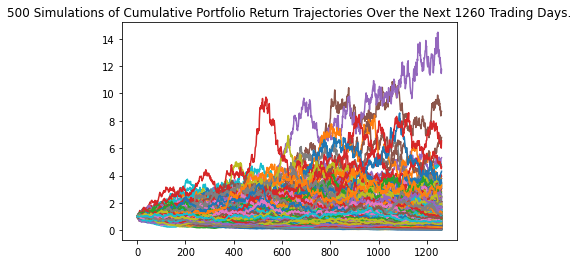

In [14]:
line_plot = MC_even_dist_TANweighted.plot_simulation()

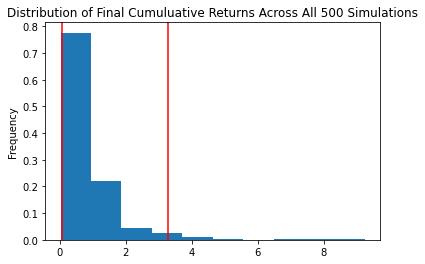

In [15]:
# Plot probability distribution and confidence intervals
dist_plot = MC_even_dist.plot_distribution()

In [9]:
# Fetch summary statistics from the Monte Carlo simulation results
even_tbl = MC_even_dist.summarize_cumulative_return()

# Print summary statistics
print(even_tbl)

count           500.000000
mean              0.814511
std               0.915084
min               0.027478
25%               0.290811
50%               0.554226
75%               1.011413
max               9.251002
95% CI Lower      0.079606
95% CI Upper      3.275336
Name: 1260, dtype: float64


In [10]:
MC_even_dist_XLEweighted = MCSimulation(
    portfolio_data = df_stock_data,
    weights = [0,1],
    num_simulation = 500,
    num_trading_days = 252*5
)

In [16]:
MC_even_dist_XLEweighted.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.003899,1.017804,0.991464,0.960179,1.023825,0.973289,1.014974,0.982567,0.994339,1.040075,...,1.042438,1.037730,0.995620,1.032121,0.995003,0.968140,0.980781,0.977369,0.979473,0.983265
2,0.969466,1.038297,1.004449,0.948806,0.962246,0.958481,1.016031,1.013007,1.008978,1.037317,...,1.041989,1.027501,0.980600,1.006192,1.015412,0.959532,0.999932,0.983639,0.962662,0.972146
3,0.959504,1.032952,0.994954,0.985839,0.947191,0.970542,1.016978,0.988615,0.996772,1.016419,...,1.071644,1.022106,0.974896,1.023548,1.020947,0.985234,1.011261,1.011089,0.959427,0.961209
4,0.978918,1.035116,1.010800,0.983667,0.992296,0.938978,1.035370,1.010388,1.004136,1.017943,...,1.123669,1.051645,1.008511,1.031665,1.053771,0.984630,1.012199,1.017815,0.964283,0.937238
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,0.774573,1.564322,0.125453,0.661957,1.818142,1.292909,0.684018,1.362801,1.720690,2.156229,...,0.689397,0.856557,0.676302,0.160108,0.517578,0.296969,0.407579,0.755208,0.442608,1.511356
1257,0.764645,1.539623,0.124226,0.677320,1.842100,1.289815,0.673069,1.361681,1.763673,2.098897,...,0.694682,0.832983,0.695202,0.159723,0.514359,0.288150,0.404593,0.753400,0.440147,1.510757
1258,0.741320,1.554090,0.123340,0.681862,1.817559,1.317208,0.649797,1.331812,1.752464,2.045408,...,0.685565,0.828435,0.675542,0.157508,0.518693,0.291190,0.399585,0.764484,0.443726,1.539919
1259,0.755571,1.560481,0.125476,0.686550,1.782492,1.302526,0.648671,1.359219,1.803565,2.051844,...,0.710422,0.830365,0.685057,0.158837,0.524012,0.297454,0.396222,0.804289,0.443832,1.565154


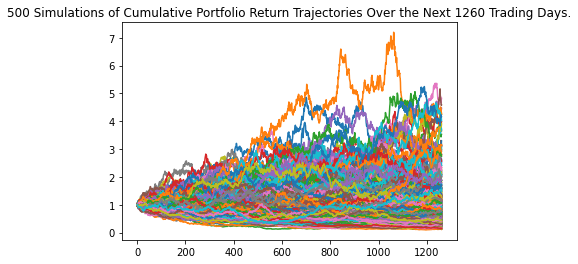

In [18]:
line_plot = MC_even_dist_XLEweighted.plot_simulation()

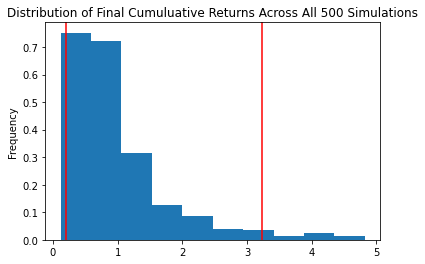

In [20]:
# Plot probability distribution and confidence intervals
dist_plot = MC_even_dist_XLEweighted.plot_distribution()

In [21]:
# Fetch summary statistics from the Monte Carlo simulation results
even_tbl = MC_even_dist_XLEweighted.summarize_cumulative_return()

# Print summary statistics
print(even_tbl)

count           500.000000
mean              0.974615
std               0.785730
min               0.115649
25%               0.468176
50%               0.735142
75%               1.197730
max               4.822741
95% CI Lower      0.193417
95% CI Upper      3.232028
Name: 1260, dtype: float64
